In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms

from torchvision.utils import make_grid
from torch.utils.data import DataLoader, Dataset
from torchvision.utils import save_image

# import dataset

# from model import initialize_weights, Generator, Discriminator
# from utils import plot_images, scale_image, unnorm
from PIL import Image

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# hyperparameters
#NOTE: according to the paper DCGAN is sensible to hyperparameters 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
REAL_SIZE = 631
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64
norm=((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))


In [ ]:
transform  = transforms.Compose(
    [
        transforms.ToPILImage(),
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]
        ),
    ]
)


In [ ]:
# scale back image
def scale_image(img):
    out = (img + 1) /2
    return out

# to plot during training
def plot_images(images, batch_size=128, cols=5, rows=5):
    fig = plt.figure(figsize=(8, 8))
    imgs = images.cpu().detach().reshape(-1, 64, 64)
    for i in range(1, cols*rows +1):
        idx = np.random.randint(batch_size)
        img = imgs[i]
        fig.add_subplot(rows, cols, i)
        plt.imshow(img)#, cmap='gray')
    plt.show()
    

def unnorm(images, means, stds):
    means = torch.tensor(means).reshape(1,3,1,1).to(device)
    stds = torch.tensor(stds).reshape(1,3,1,1).to(device)
    return images*stds+means

In [ ]:
class BAYCDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None):
        super(BAYCDataset, self).__init__()
        self.annotations = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform
    def __len__(self):
        return len(self.annotations)
    def __getitem__(self, idx):
        img_hash = self.annotations['IPFS HASH'][idx]
        img_path = os.path.join(self.root_dir, img_hash +'.png')
        #img = plt.imread(img_path)
        img = np.array(Image.open(img_path).convert("RGB"))
        if self.transform:
            img = self.transform(img)
        return img

In [ ]:
# csv_file = './bayc/bayc/hashes.csv'
# root_dir = './bayc/bayc/'
csv_file = "/content/drive/MyDrive/bayc/hashes.csv"
root_dir = "/content/drive/MyDrive/bayc/"
dataset = BAYCDataset(csv_file, root_dir, transform=transform)

In [ ]:
loader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE,drop_last=True, shuffle=True)


In [ ]:
def show_batch(data_loader):
    for images in data_loader:
        images = images.to(device)
        batch_size = len(images)
        fig, ax = plt.subplots(figsize=(15, 15))
        ax.set_xticks([]) 
        ax.set_yticks([])
        unnorm_images = unnorm(images, *norm).cpu()
        ax.imshow(make_grid(unnorm_images[:batch_size], nrow=8).permute(1, 2, 0).clamp(0,1))
        break

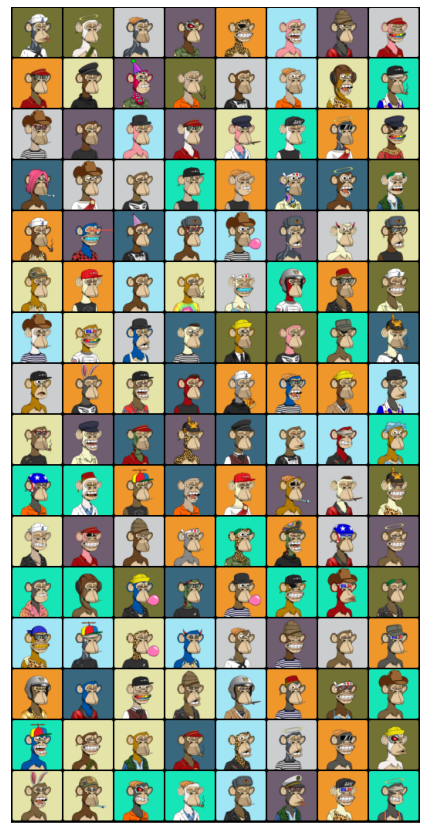

In [ ]:
show_batch(loader)

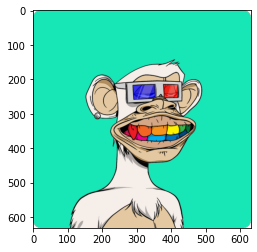

In [ ]:
from PIL import Image
idx = np.random.randint(len(dataset))
img_hash = dataset.annotations['IPFS HASH'][idx]
img = Image.open(os.path.join(dataset.root_dir, img_hash +'.png'))
plt.imshow(img);

In [ ]:
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d, nn.Linear)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)
            

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super().__init__()
        # Input: N x channels_img x 64 x 64
        self.disc = nn.Sequential(
            nn.Conv2d(
                channels_img, features_d, kernel_size=5, stride=2, padding=2
            ),  # 32x32
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 5, 2, 2),  # 16x16
            self._block(features_d * 2, features_d * 4, 5, 2, 2),  # 8x8
            self._block(features_d * 4, features_d * 8, 5, 2, 2),  # 4x4
            nn.Flatten(),  # 1x1
            nn.Linear(features_d * 8*4*4,1),
            nn.Sigmoid(),
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,  # because we are using batch norm
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        return self.disc(x)



class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super().__init__()
        # Input: N x z_dim x 1 x 1
        # Reshape it in forward to N x _ x 4 x 4

        self.dense = nn.Linear(z_dim, features_g * 16 * 4 * 4) # 
        self.gen = nn.Sequential(
            self._block(features_g * 16, features_g * 8, 5, 2, 2, 1),  # 8x8
            self._block(features_g * 8, features_g * 4, 5, 2, 2, 1),  # 16x16
            self._block(features_g * 4, features_g * 2, 5, 2, 2, 1),  # 32x32
            nn.ConvTranspose2d(
                features_g * 2,
                channels_img,
                kernel_size=5,
                stride=2,
                padding=2,
                output_padding=1,
            ),  # 64x64
            nn.Tanh(),  # [-1, 1]
        )

    def _block(
        self, in_channels, out_channels, kernel_size, stride, padding, output_padding
    ):
        return nn.Sequential(
            nn.BatchNorm2d(in_channels),
            nn.ReLU(),
            nn.ConvTranspose2d(
                in_channels=in_channels,
                out_channels=out_channels,
                kernel_size=kernel_size,
                stride=stride,
                padding=padding,
                output_padding=output_padding,
                bias=False,  # because we are using batch norm
            ),
            
            
        )

    def forward(self, x):
        x = self.dense(x)
        x = x.view(x.size(0),-1,4,4)
        return self.gen(x)

In [ ]:
# instantiate both models
generator = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
discriminator = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
#generator = torch.load("./generator.pth")
#discriminator = torch.load("./discriminator.pth")

In [ ]:
# init weights
initialize_weights(generator)
initialize_weights(discriminator)

In [ ]:
# set mode to train, redundant here
generator.train()
discriminator.train()


Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Flatten(start_dim=1, end_dim=-1)
    (6): Linear(in_features=8192, out_features=1, bias=T

In [ ]:
# optimizer and loss, maybe BCEWithLogits is better here
opt_g = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_d = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

In [ ]:
drive_path = "/content/drive/MyDrive/bayc/"
save_path = os.path.join(drive_path, 'gan_images_bayc')
model_path = os.path.join(drive_path, 'models')

if not os.path.exists(save_path):
    os.makedirs(save_path)

if not os.path.exists(model_path):
    os.makedirs(model_path)


In [ ]:
torch.save(generator, os.path.join(model_path, "generator.pth"))
torch.save(discriminator, os.path.join(model_path, "discriminator.pth"))

In [ ]:
def show_batch_images(images, title=""):
    images = images.to(device)
    batch_size = len(images)
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.set_xticks([]) 
    ax.set_yticks([])
    ax.set_title(title)
    unnorm_images = unnorm(images, *norm).cpu()
    ax.imshow(make_grid(unnorm_images[:batch_size], nrow=8).permute(1, 2, 0).clamp(0,1))
    plt.show()
    
    

Epoch [1/25] Batch 0/78                     Loss D: 0.6833, loss G: 0.8377


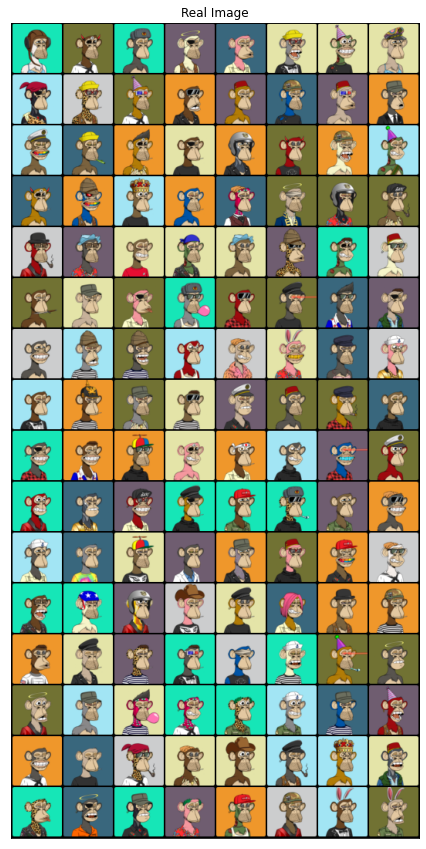

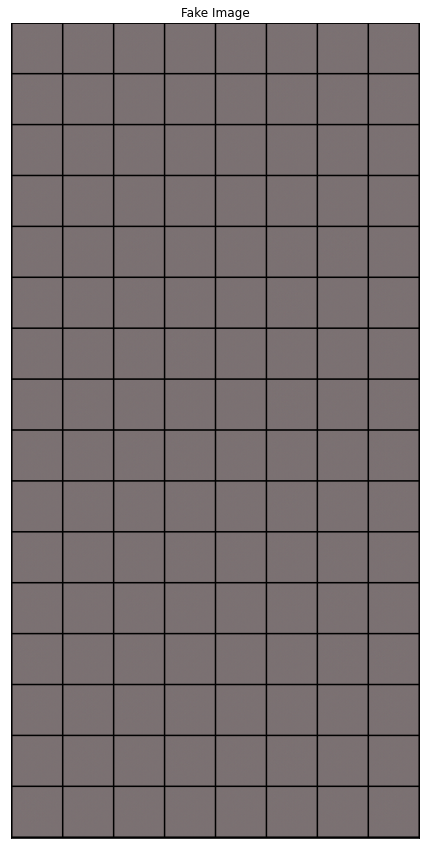

Epoch [2/25] Batch 0/78                     Loss D: 0.0181, loss G: 4.0994


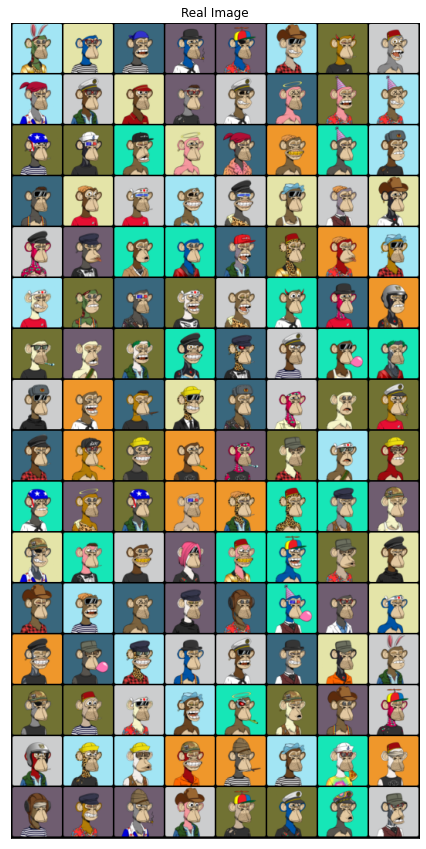

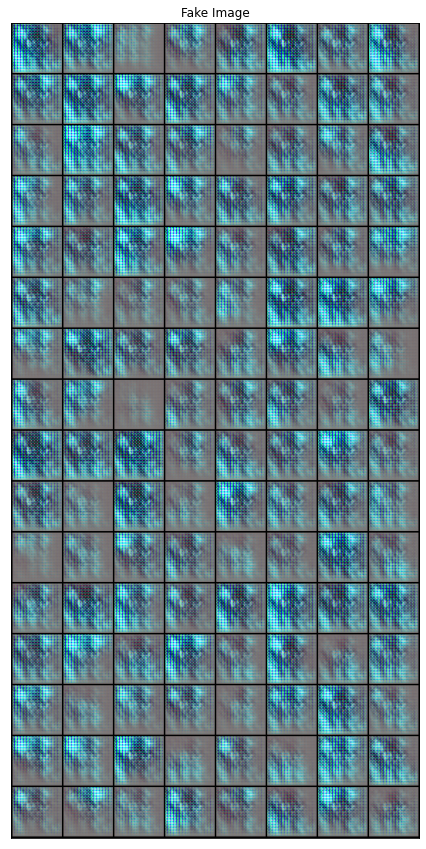

Epoch [3/25] Batch 0/78                     Loss D: 0.1404, loss G: 3.3596


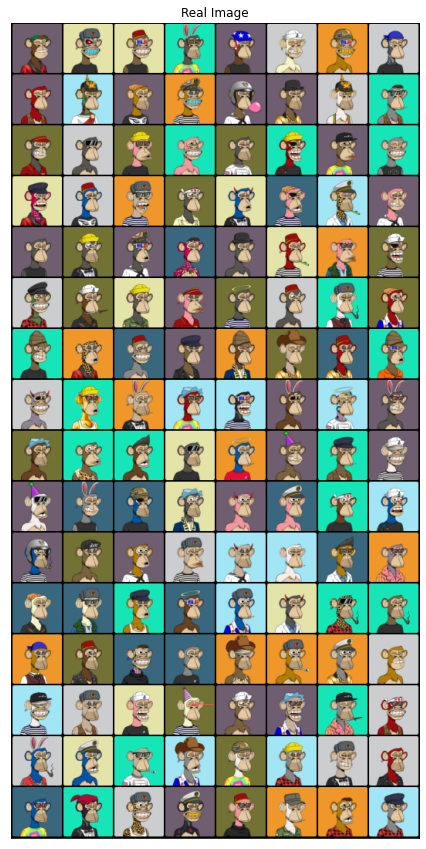

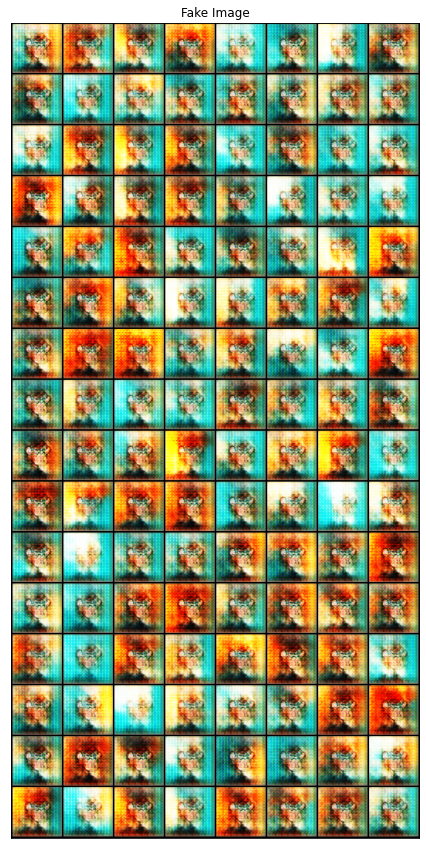

Epoch [4/25] Batch 0/78                     Loss D: 0.0951, loss G: 4.4665


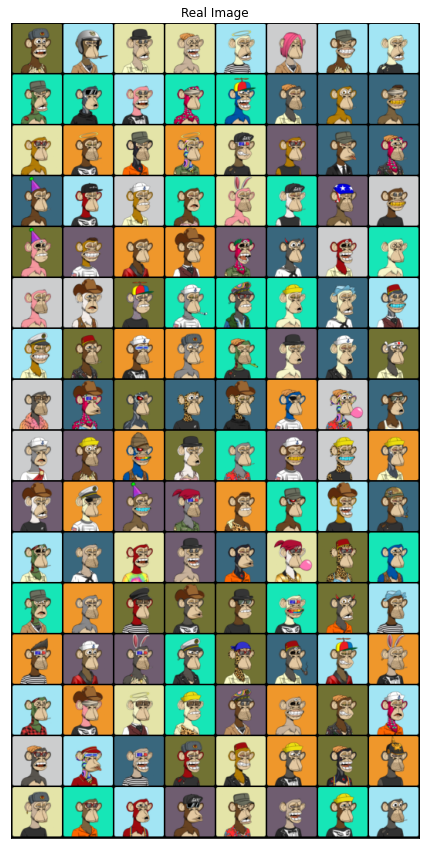

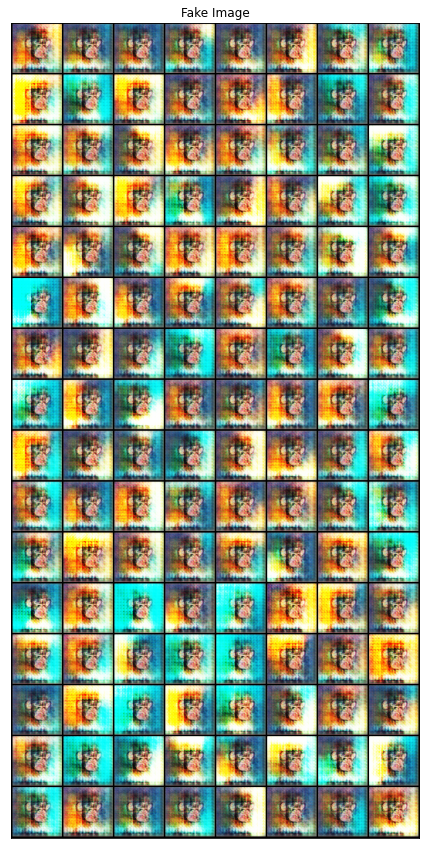

Epoch [5/25] Batch 0/78                     Loss D: 0.0671, loss G: 4.7622


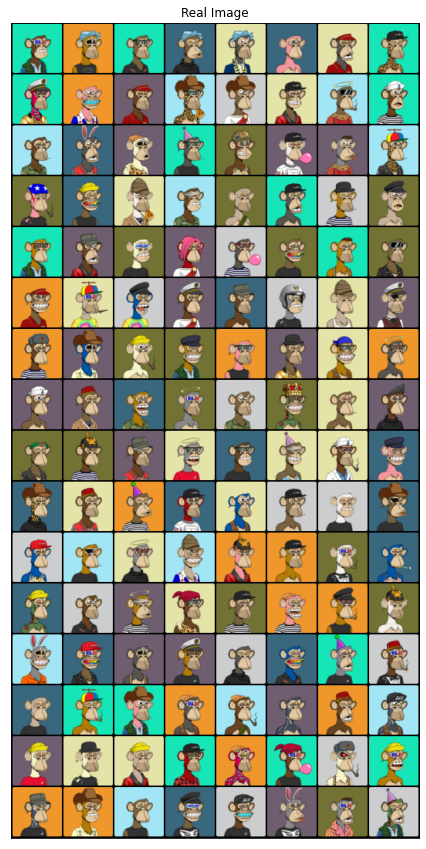

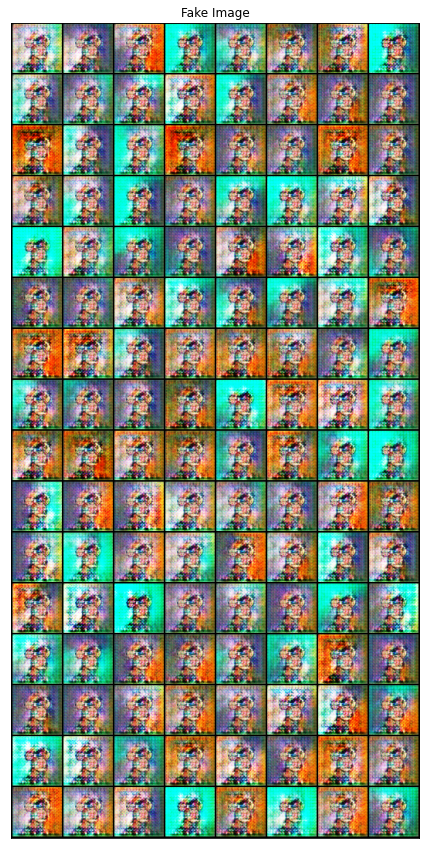

Epoch [6/25] Batch 0/78                     Loss D: 0.1197, loss G: 3.4840


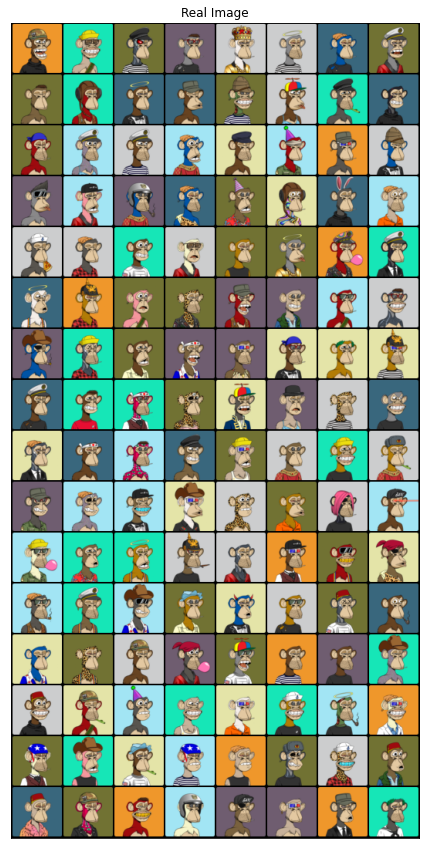

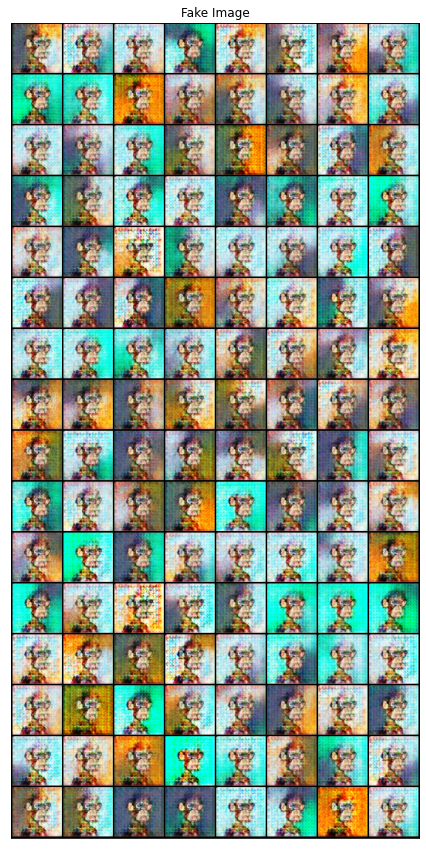

Epoch [7/25] Batch 0/78                     Loss D: 0.2208, loss G: 2.7170


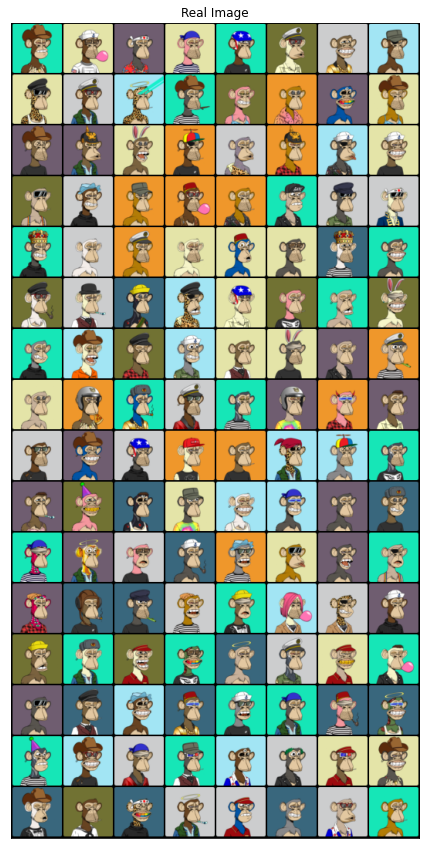

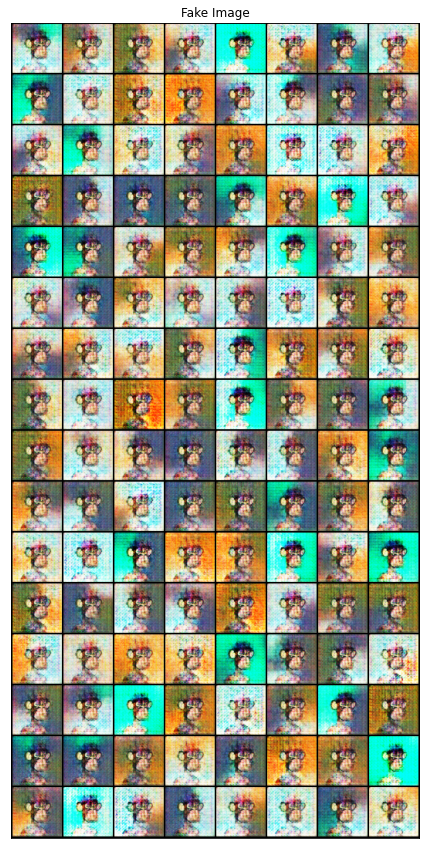

Epoch [8/25] Batch 0/78                     Loss D: 0.1242, loss G: 4.0783


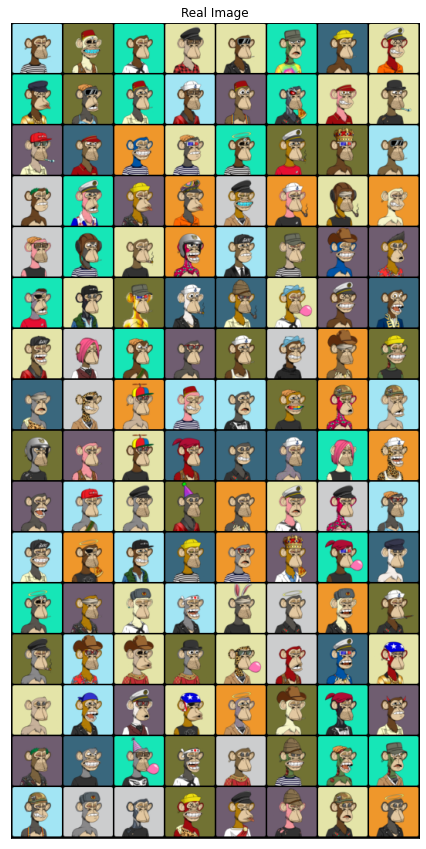

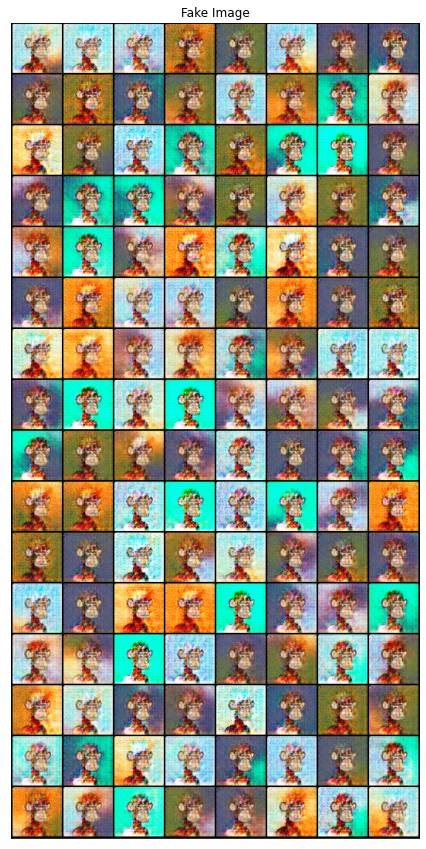

Epoch [9/25] Batch 0/78                     Loss D: 0.1510, loss G: 2.8438


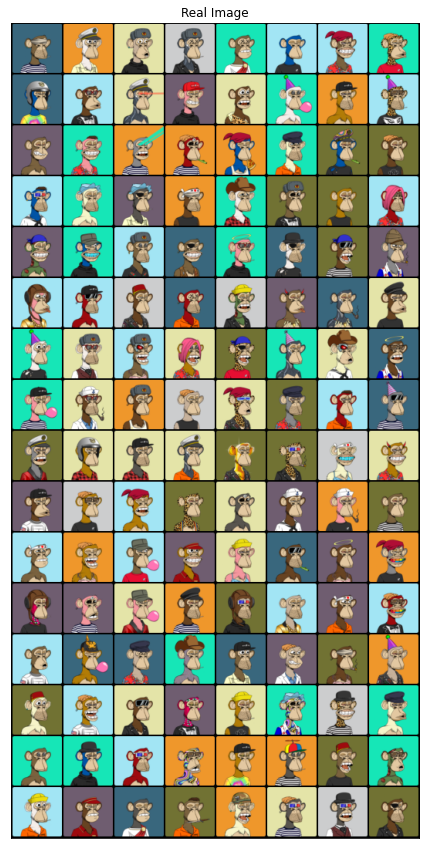

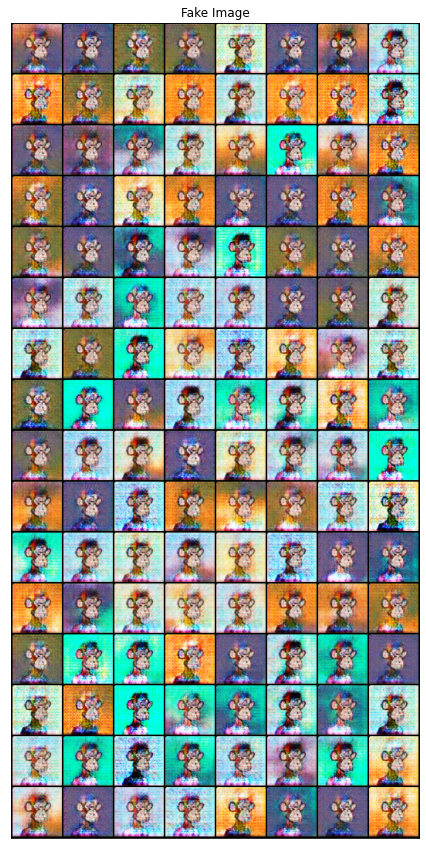

Epoch [10/25] Batch 0/78                     Loss D: 0.3204, loss G: 4.5045


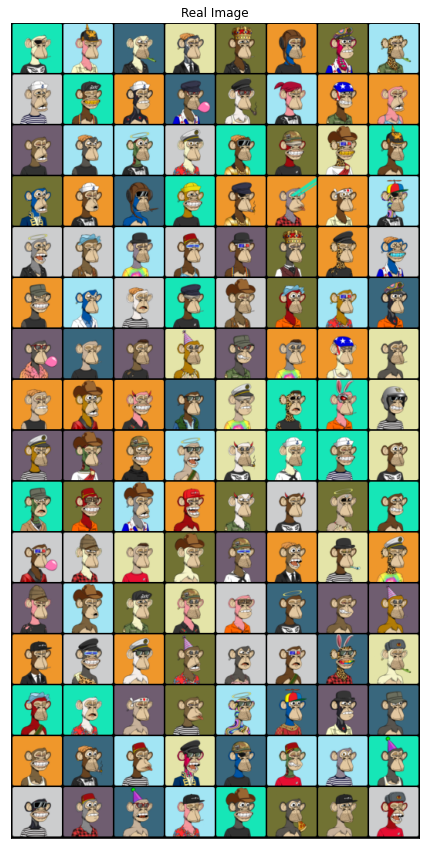

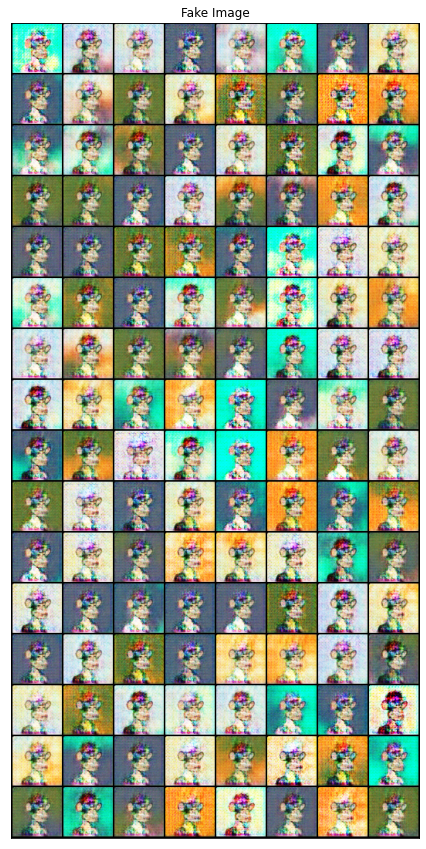

Epoch [11/25] Batch 0/78                     Loss D: 0.4125, loss G: 1.3649


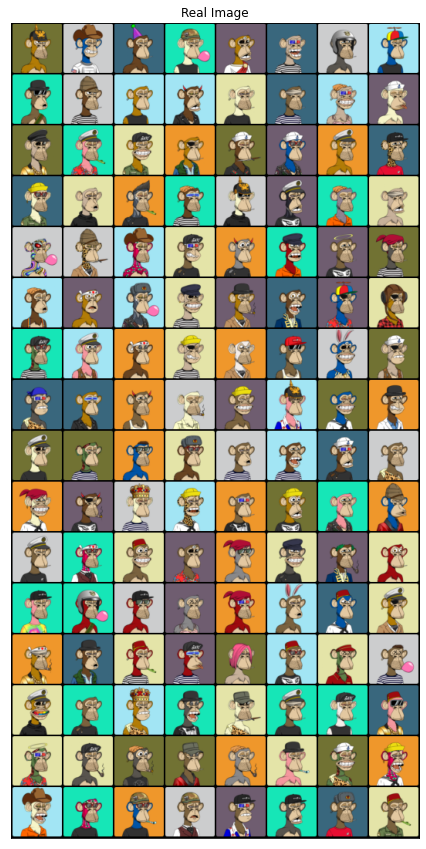

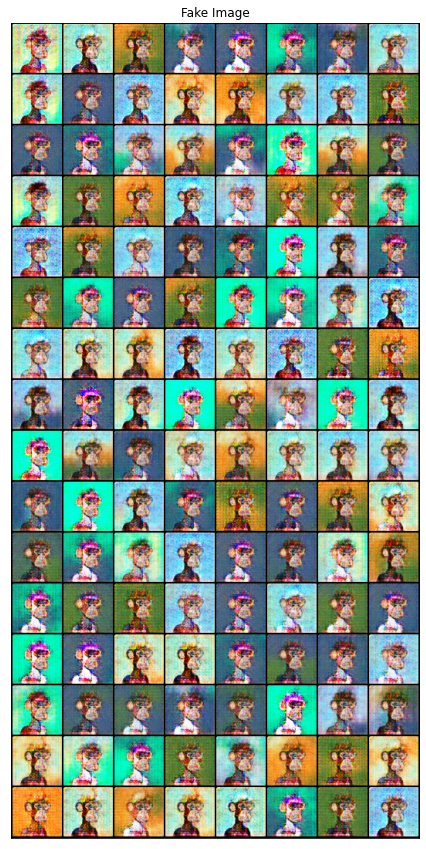

Epoch [12/25] Batch 0/78                     Loss D: 0.0451, loss G: 4.1785


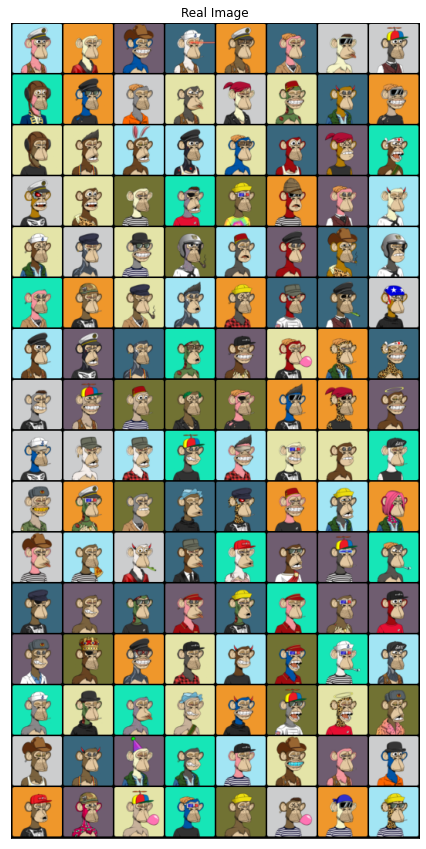

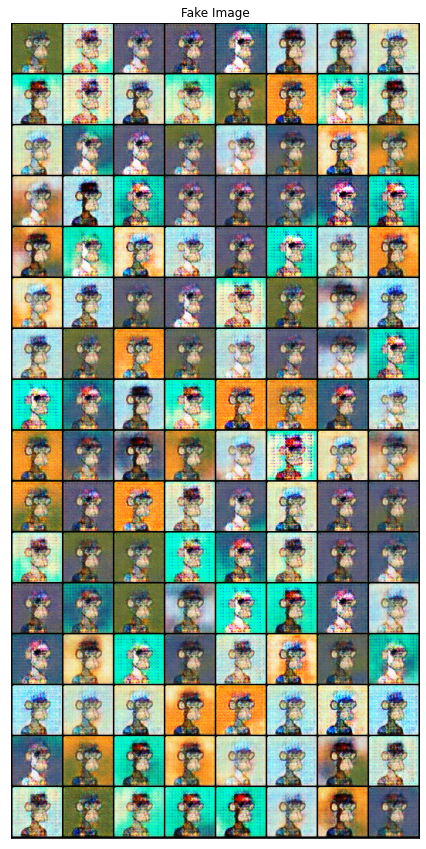

Epoch [13/25] Batch 0/78                     Loss D: 0.0695, loss G: 4.0322


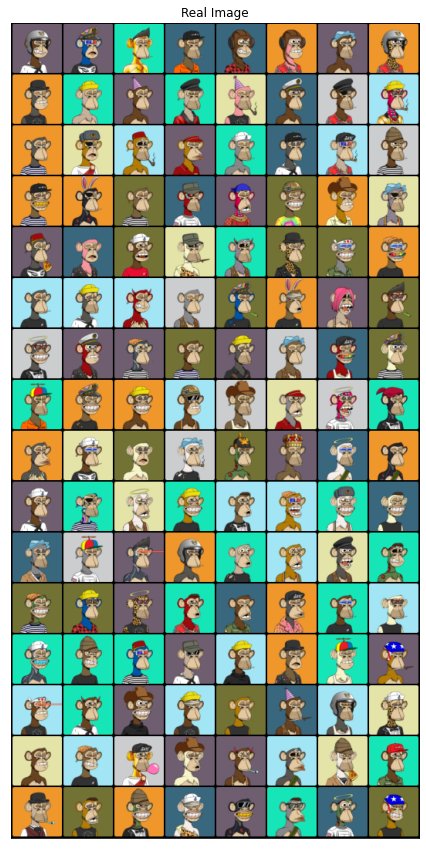

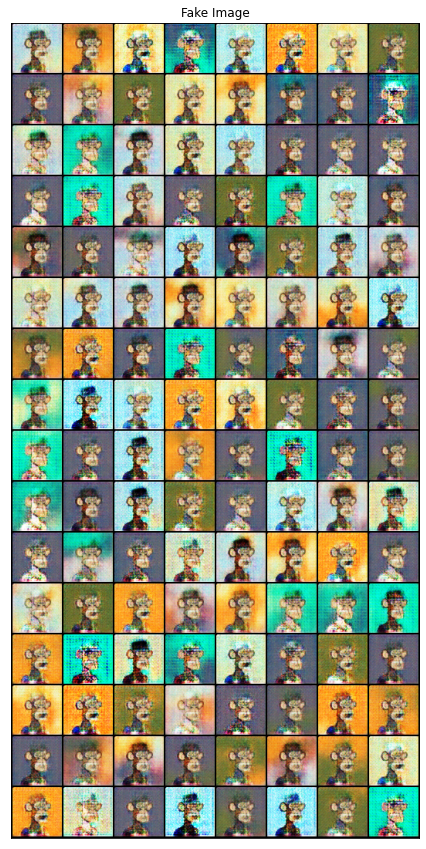

Epoch [14/25] Batch 0/78                     Loss D: 0.0362, loss G: 5.5673


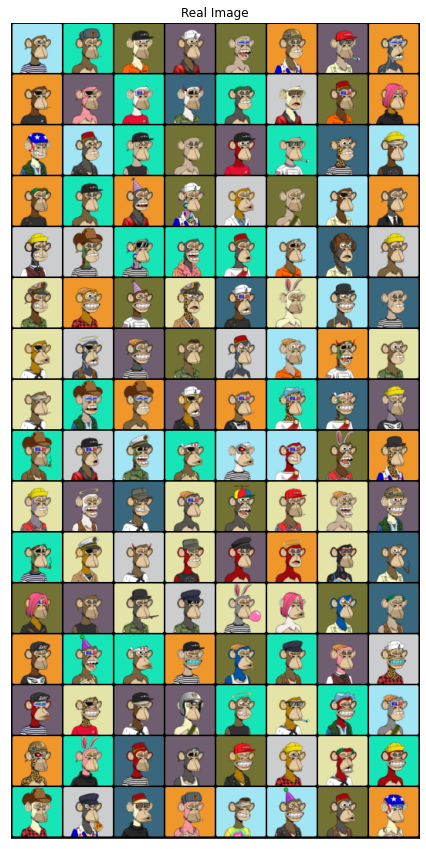

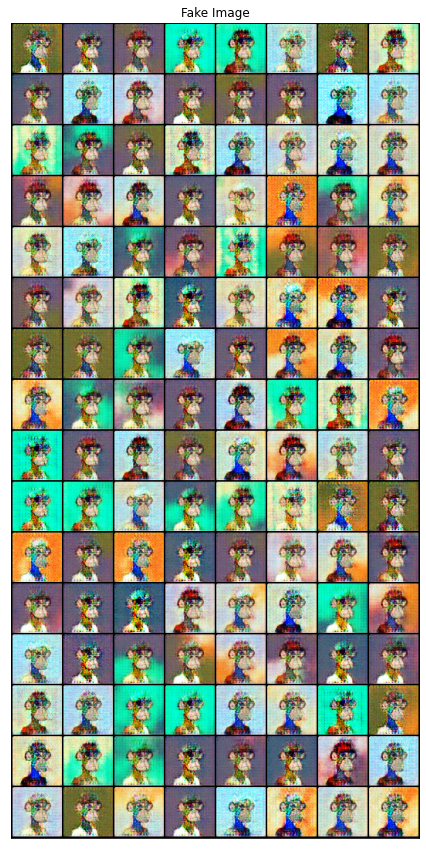

Epoch [15/25] Batch 0/78                     Loss D: 0.2987, loss G: 2.8274


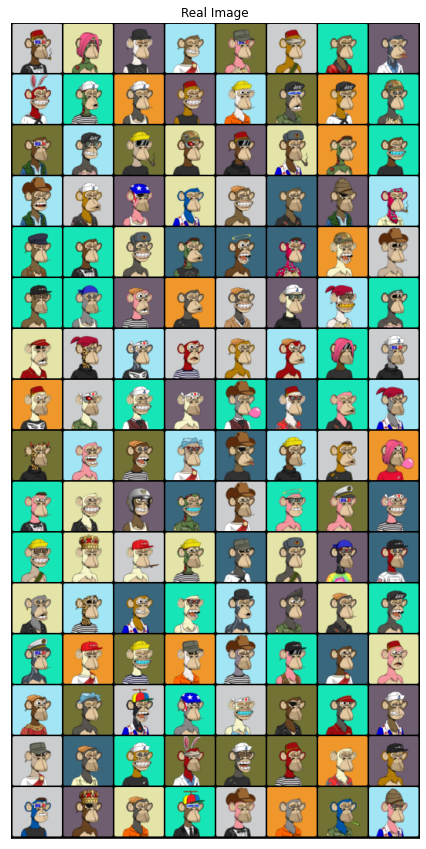

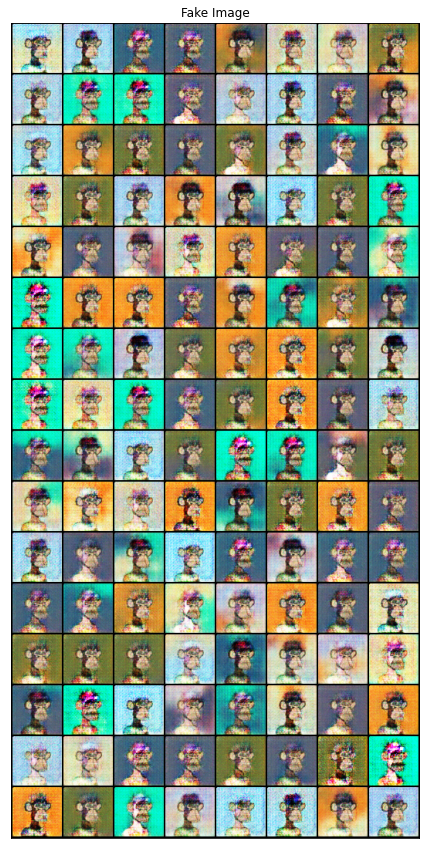

Epoch [16/25] Batch 0/78                     Loss D: 0.0348, loss G: 4.3518


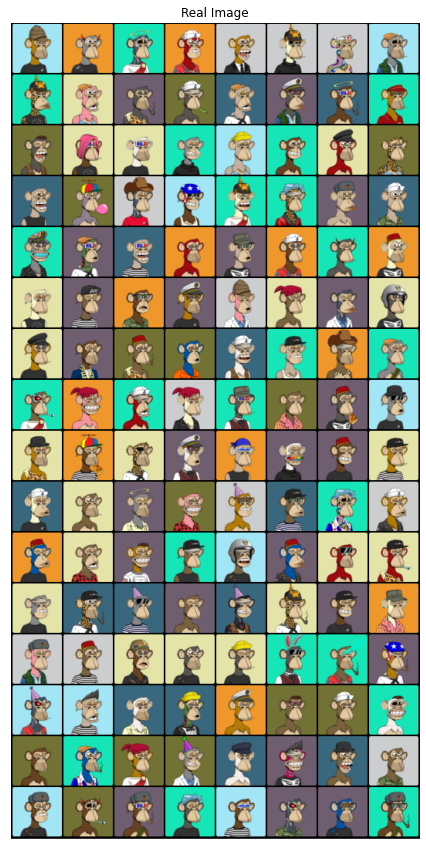

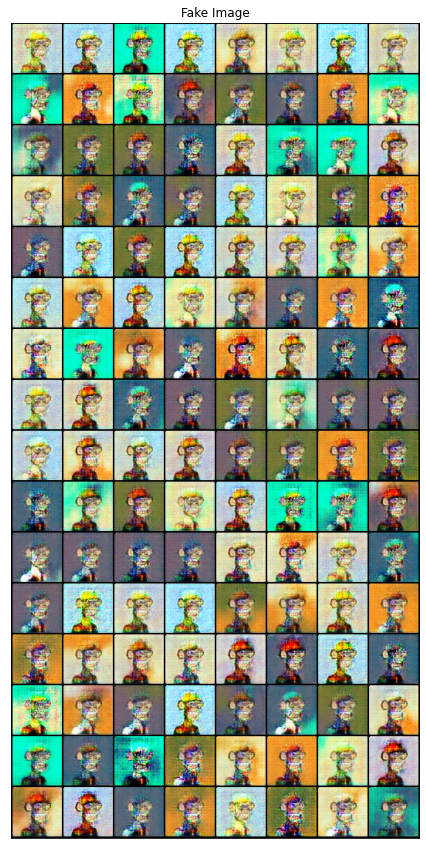

Epoch [17/25] Batch 0/78                     Loss D: 0.1865, loss G: 5.3717


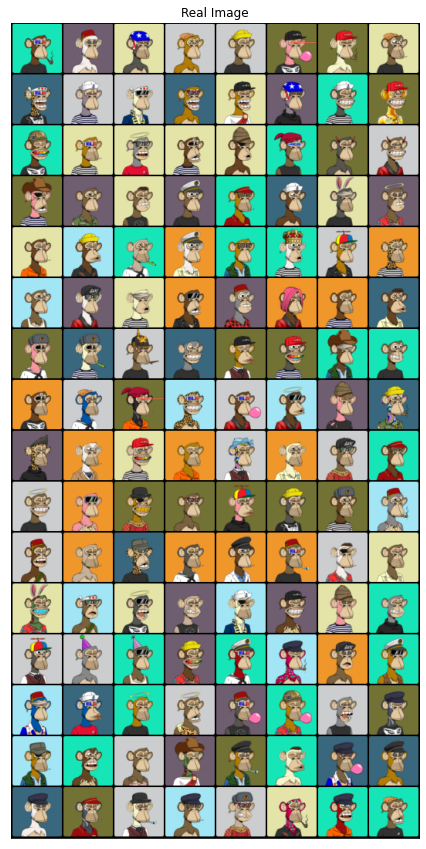

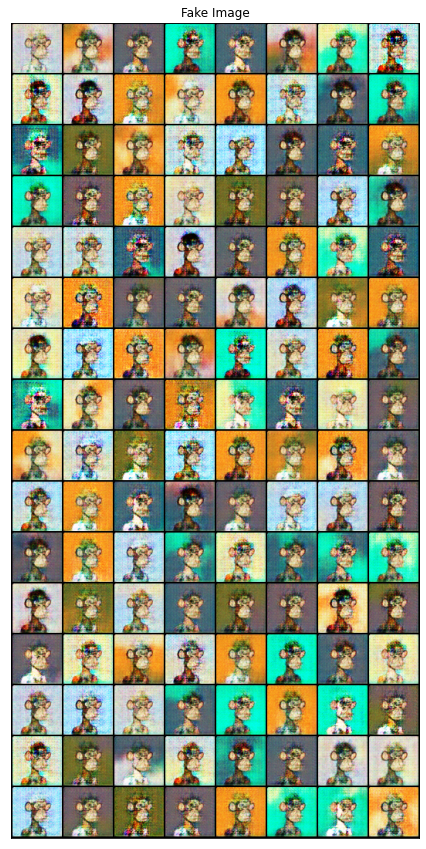

Epoch [18/25] Batch 0/78                     Loss D: 0.1330, loss G: 3.8761


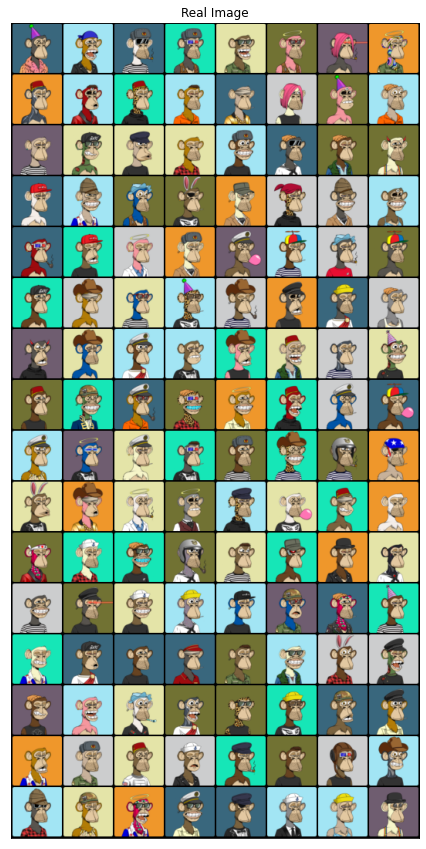

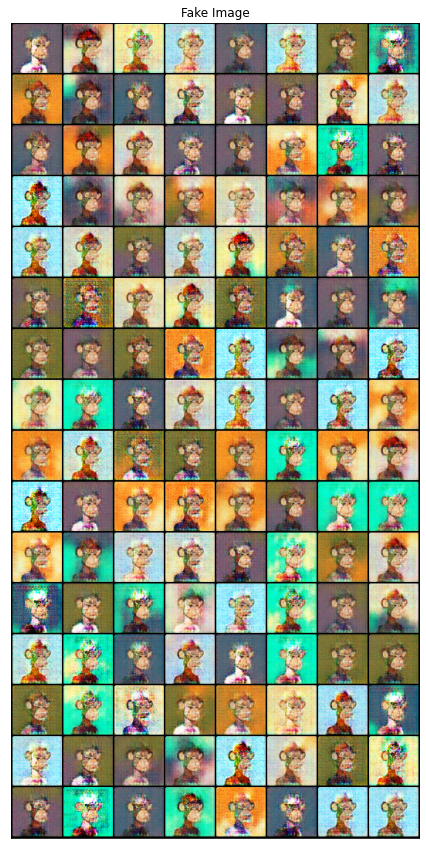

Epoch [19/25] Batch 0/78                     Loss D: 0.0241, loss G: 4.1548


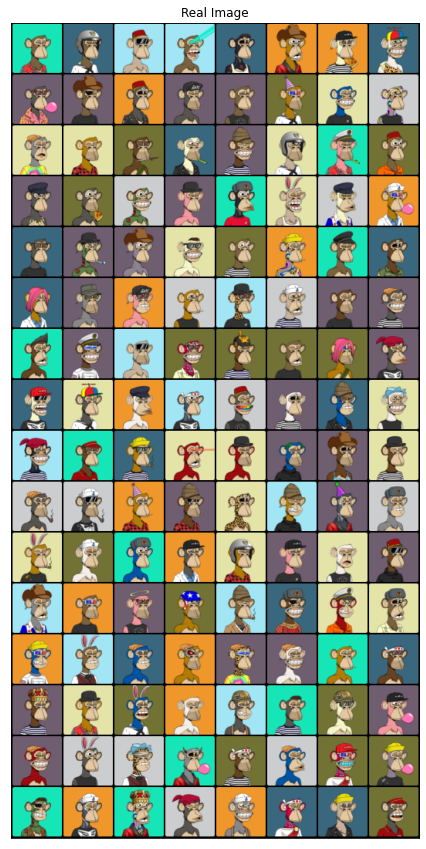

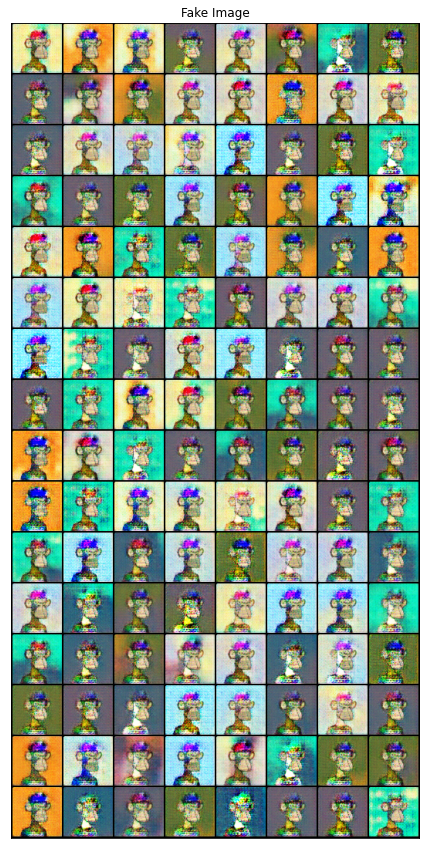

Epoch [20/25] Batch 0/78                     Loss D: 0.0385, loss G: 6.3004


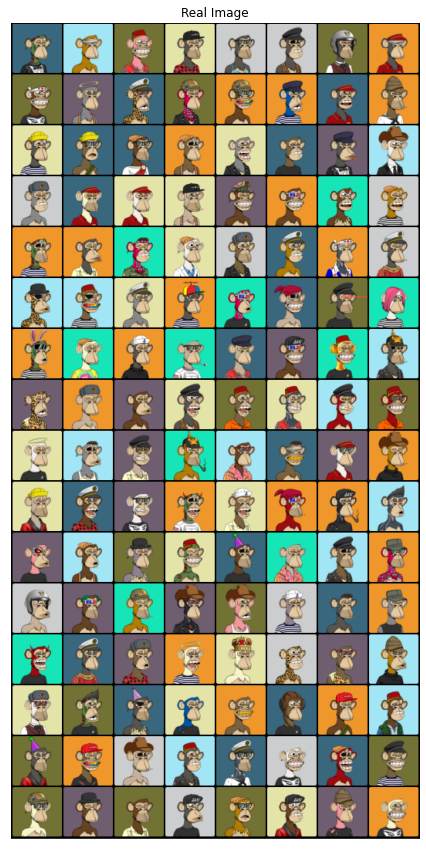

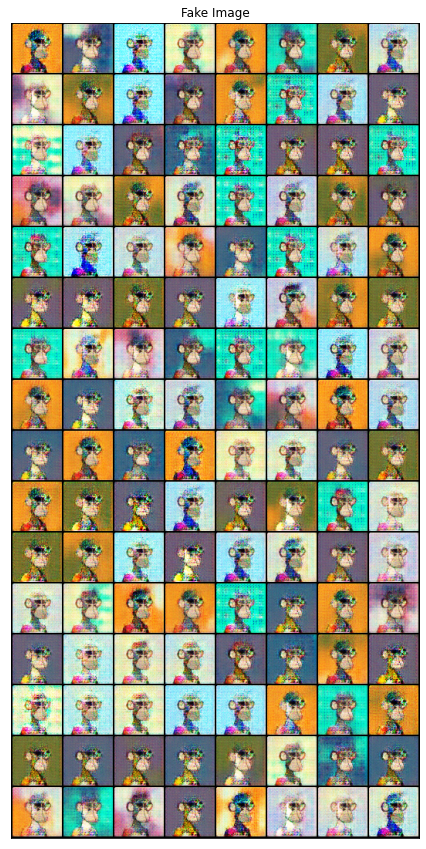

Epoch [21/25] Batch 0/78                     Loss D: 0.0602, loss G: 3.6441


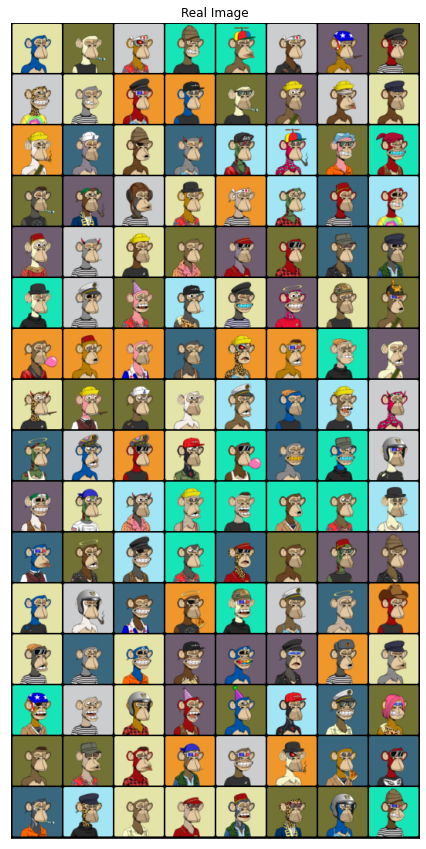

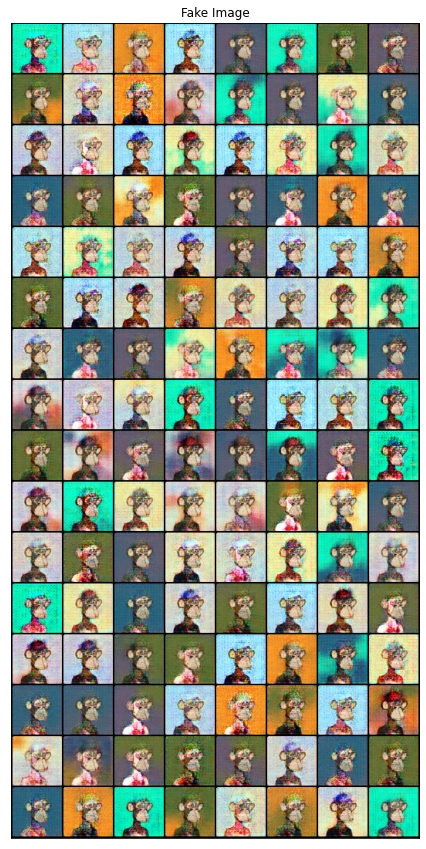

Epoch [22/25] Batch 0/78                     Loss D: 0.0227, loss G: 4.9605


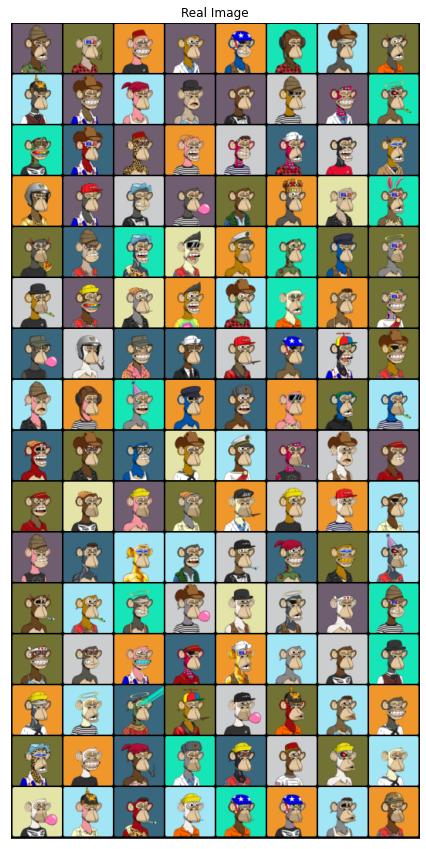

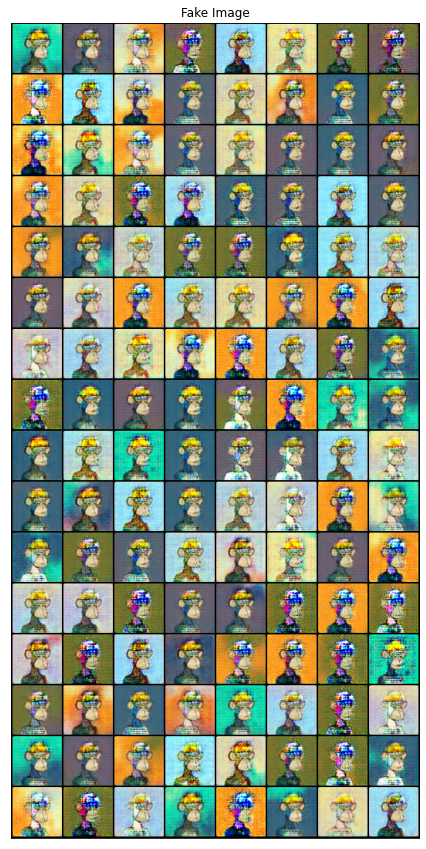

Epoch [23/25] Batch 0/78                     Loss D: 0.0034, loss G: 6.4490


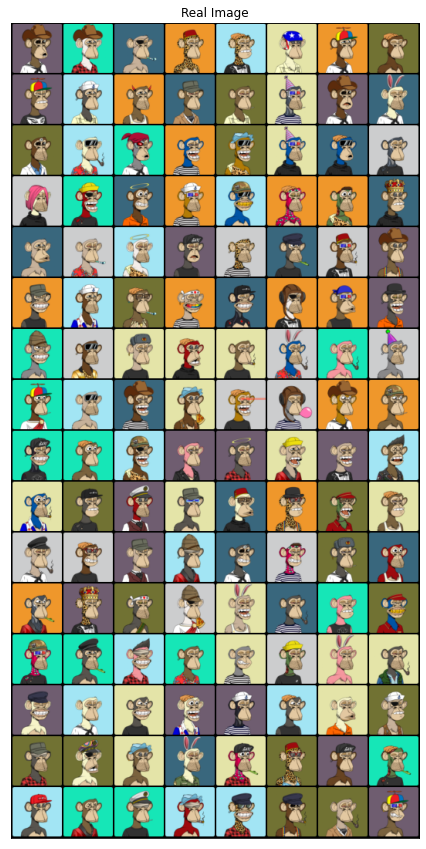

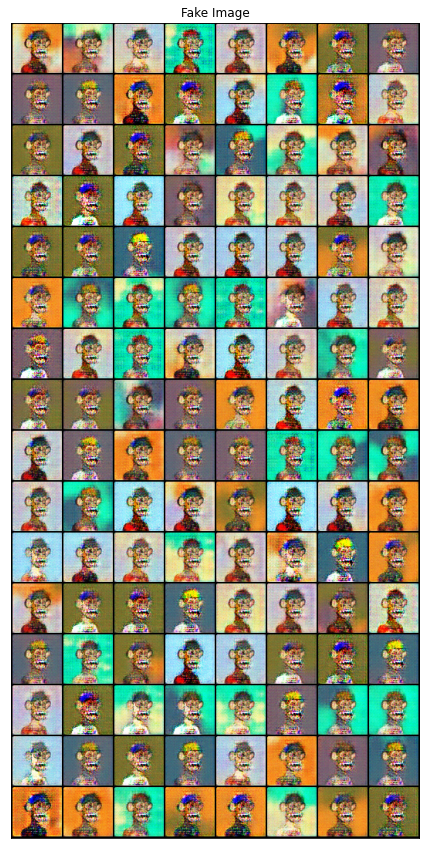

Epoch [24/25] Batch 0/78                     Loss D: 0.0041, loss G: 6.1772


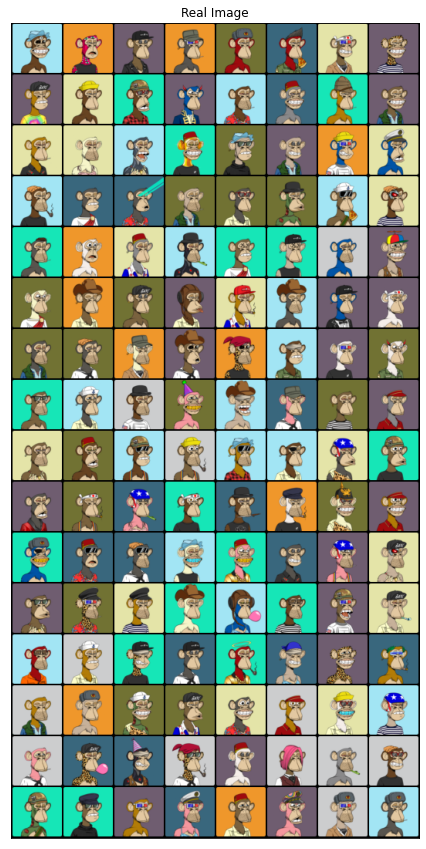

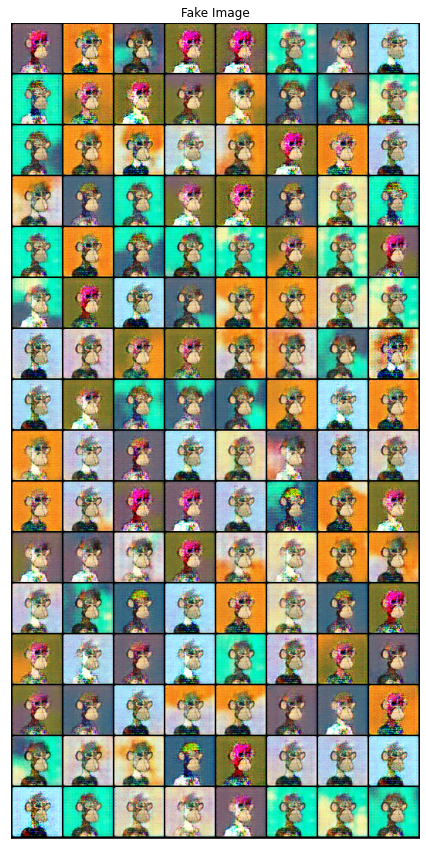

Epoch [25/25] Batch 0/78                     Loss D: 0.2455, loss G: 5.7016


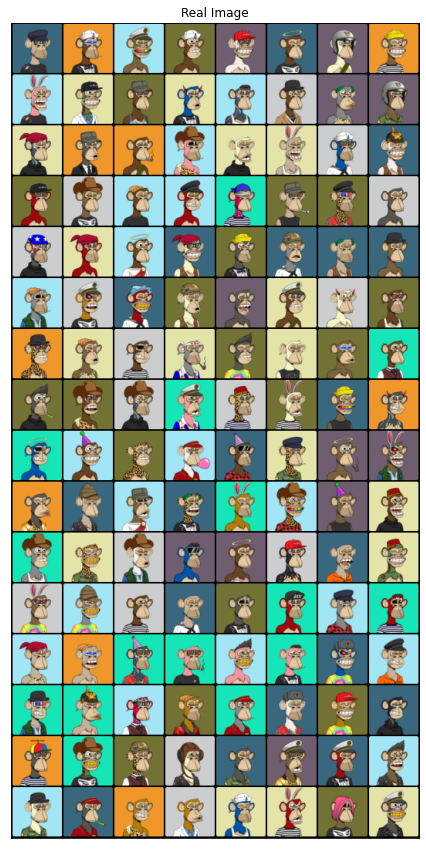

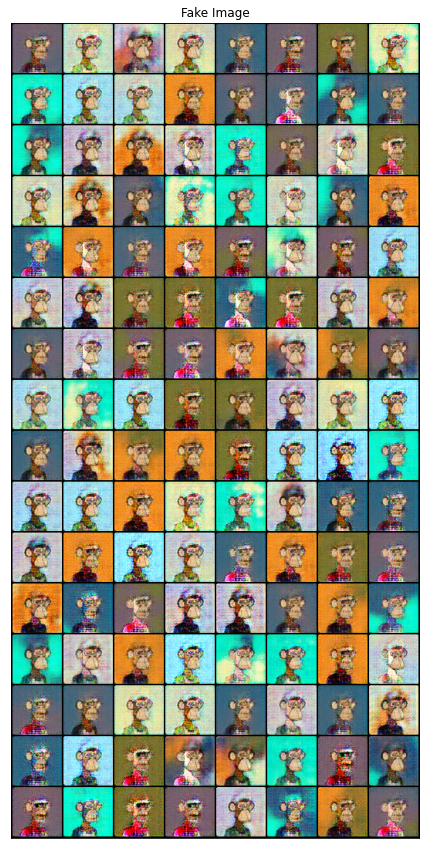

MODEL SAVED


In [ ]:
run = 1
NUM_EPOCHS = 25
NUMS_TRAINS_GENERATOR = 1
d_losses = np.zeros(NUM_EPOCHS)
g_losses = np.zeros(NUM_EPOCHS)

for epoch in range(NUM_EPOCHS):
    d_loss = []
    g_loss = []
    
    for idx, inputs in enumerate(loader):
        inputs = inputs.to(device)
        noise = torch.randn((BATCH_SIZE, Z_DIM)).to(device)

        ### Train Discriminator
        ## get fake images
        fakes = generator(noise)
        
        outputs_real = discriminator(inputs).view(-1)
        outputs_fake = discriminator(fakes).view(-1)

        loss_real = criterion(outputs_real, torch.ones_like(outputs_real))
        loss_fake = criterion(outputs_fake, torch.zeros_like(outputs_fake))
        loss_d = 0.5 * (loss_real + loss_fake)

        opt_d.zero_grad()
        loss_d.backward(retain_graph=True)
        opt_d.step()
        d_loss.append(loss_d.item())

        ## Train generator more times more than disc
        for _ in range(NUMS_TRAINS_GENERATOR):
            noise = torch.randn((BATCH_SIZE, Z_DIM)).to(device)
            fakes = generator(noise)
            outputs_fake = discriminator(fakes).view(-1)
            loss_g = criterion(outputs_fake, torch.ones_like(outputs_fake))
            opt_g.zero_grad()
            loss_g.backward()
            opt_g.step()
        g_loss.append(loss_g.item())

        d_losses[epoch] = np.mean(d_loss)
        g_losses[epoch] = np.mean(g_loss)

        # Print losses occasionally and print to tensorboard
        if idx % 100 == 0:
            print(
                f"Epoch [{epoch + 1}/{NUM_EPOCHS}] Batch {idx}/{len(loader)} \
                    Loss D: {loss_d:.4f}, loss G: {loss_g:.4f}"
            )
            
            show_batch_images(inputs, "Real Image")
            show_batch_images(fakes, "Fake Image")
            save_image(unnorm(fakes, *norm),  os.path.join(save_path,f"{run}_{epoch}_{idx//100}.png" ) )
            
torch.save(generator, os.path.join(model_path, "generator.pth"))
torch.save(discriminator, os.path.join(model_path, "discriminator.pth"))
print("MODEL SAVED")

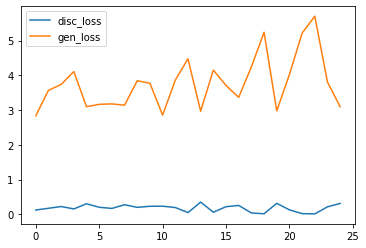

In [ ]:
# some plots
plt.plot(d_losses, label="disc_loss")
plt.plot(g_losses, label="gen_loss")
plt.legend()
plt.show()

In [ ]:
generator.eval()
discriminator.eval()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Flatten(start_dim=1, end_dim=-1)
    (6): Linear(in_features=8192, out_features=1, bias=T

In [ ]:
def show_sample():
    noise = torch.randn((1, 100)).to(device)
    fake = generator(noise)
    unnorm_images = unnorm(fake, *norm).permute(0,2,3,1).clamp(0,1).cpu().detach().numpy()
    plt.imshow(unnorm_images[0])
    plt.show()

    

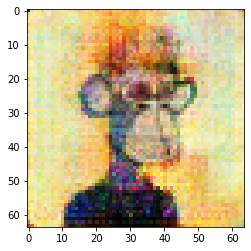

Continue? [Y/n]y


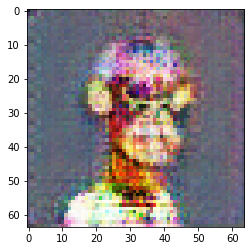

KeyboardInterrupt: ignored

In [ ]:
while True:
    show_sample()
    ans = input("Continue? [Y/n]")
    if ans and ans.lower().startswith("n"):
        break
    else:
        plt.cla()
        